In [6]:
import pandas as pd
pd.set_option('display.max_columns', 500)
import numpy as np
import plotly.express as px
import geopandas as gpd
from geopandas import GeoDataFrame
from shapely.geometry import Point
from matplotlib import pyplot as plt
import folium

In [3]:
df_full = pd.read_csv("./Data/Data_new/weather_NL.csv", skiprows=95)
df_full.columns = df_full.columns.map(lambda x: x.lstrip())
for col in df_full.columns:
    df_full[col] = pd.to_numeric(df_full[col], errors='coerce')
df_full.head()

,# STN,YYYYMMDD,DDVEC,FHVEC,FG,FHX,FHXH,FHN,FHNH,FXX,...,VVNH,VVX,VVXH,NG,UG,UX,UXH,UN,UNH,EV24
0,209,20120414,359.0,49.0,51.0,100.0,22.0,10.0,5.0,120.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,209,20120415,5.0,105.0,107.0,130.0,16.0,90.0,1.0,160.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,209,20120416,335.0,62.0,68.0,100.0,6.0,20.0,22.0,150.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,209,20120417,181.0,104.0,106.0,150.0,13.0,50.0,1.0,200.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,209,20120418,161.0,88.0,93.0,110.0,1.0,80.0,5.0,190.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
#df = df_full[df_full['# STN']==350]
df= df_full[['# STN','YYYYMMDD','TG', 'TN','TX', 'SQ', 'UX',  'UN', 'NG','SP']]
rename_dict = {
    '# STN': 'Station_Number',
    'YYYYMMDD': 'Date',
    'TG': 'Daily mean temperature',
    'TN': 'Minimum temperature',
    'TX': 'Maximum temperature',
    'SQ' :'Sunshine duration',
    'UX': 'Maximum relative atmospheric humidity (%)',
    'UN': 'Minimum relative atmospheric humidity(%)',
    'NG':'Average daily cloud cover',
    'SP':'Maximum potential sunshine duration (%)' 
}
df = df.rename(columns = rename_dict)

In [5]:
df['Date'] = pd.to_datetime(df['Date'], format='%Y%m%d')
df['day_of_week'] = df['Date'].dt.weekday
df['day_name'] = df['Date'].dt.day_name()
df['week']=df['Date'].dt.week
df['month'] = df['Date'].apply(lambda x:x.month)
df['year'] = df['Date'].apply(lambda x:x.year)
df['day_of_year']= df['Date'].dt.dayofyear
df['month_name']= df['Date'].dt.month_name()
df['Daily mean temperature'] = df['Daily mean temperature']/10
df['Minimum temperature'] = df['Minimum temperature']/10
df['Maximum temperature'] = df['Maximum temperature']/10
df['Sunshine duration'] = df['Sunshine duration']/10
df = df[df['year']!= 2022]
#df.set_index(['Station_Number','Date'])

C:\Temp\ipykernel_15232\1650019339.py:4: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  df['week']=df['Date'].dt.week


In [6]:
df1 =  df.groupby(['year','month', 'Station_Number'], dropna=False).agg({'Average daily cloud cover':'mean'})  
df1.reset_index(inplace = True)
df1= df1.rename(columns = {"Average daily cloud cover":"Mean_Average daily cloud cover"})

In [7]:
df2 =  df.groupby(['year','month', 'Station_Number'],dropna=False).agg({'Sunshine duration':'mean'})  
df2.reset_index(inplace = True)
df2= df2.rename(columns = {"Sunshine duration":"Mean Sunshine duration"})

In [8]:
df = pd.merge(df,df1, left_on = ['year','month', 'Station_Number'], right_on = ['year', 'month', 'Station_Number'] )
df['Average daily cloud cover'].fillna(value = df['Mean_Average daily cloud cover'], inplace = True)

df = pd.merge(df,df2, left_on = ['year','month', 'Station_Number'], right_on = ['year', 'month', 'Station_Number'] )
df['Sunshine duration'].fillna(value = df['Mean Sunshine duration'], inplace = True)

In [9]:
df_agg = df.groupby(['month','year', 'Station_Number'],dropna = False).aggregate('mean')

Daily mean temperature  Minimum temperature  \
month year Station_Number                                                
1     2013 209                                NaN                  NaN   
           210                           2.167742            -0.577419   
           225                                NaN                  NaN   
           235                           2.461290             0.554839   
           240                           2.116129            -0.477419   
...                                           ...                  ...   
12    2021 370                           5.477419             2.541935   
           375                           5.309677             2.338710   
           377                           5.558065             2.916129   
           380                           5.461290             3.058065   
           391                           5.238710             2.461290   

                           Maximum temperature  Sunshine duration  \
month year Station_Number                                           
1     2013 209                             NaN                NaN   
           210                        4.290323           2.909677   
           225                             NaN                NaN   
           235                        4.138710           2.587097   
           240                        4.238710           2.441935   
...                                        ...                ...   
12    2021 370                        7.906452           1.383871   
           375                        7.693548           1.441935   
           377                        7.793548           1.241935   
           380                        7.558065           1.074194   
           391                        7.358065           1.190323   

                           Maximum relative atmospheric humidity (%)  \
month year Station_Number                                              
1     2013 209                                                   NaN   
           210                                             94.580645   
           225                                                   NaN   
           235                                             95.129032   
           240                                             94.290323   
...                                                              ...   
12    2021 370                                             97.064516   
           375                                             97.096774   
           377                                             96.258065   
           380                                             95.645161   
           391                                             97.387097   

                           Minimum relative atmospheric humidity(%)  \
month year Station_Number                                             
1     2013 209                                                  NaN   
           210                                            76.032258   
           225                                                  NaN   
           235                                            76.612903   
           240                                            76.322581   
...                                                             ...   
12    2021 370                                            80.290323   
           375                                            81.741935   
           377                                            81.161290   
           380                                            80.483871   
           391                                            81.161290   

                           Average daily cloud cover  \
month year Station_Number                              
1     2013 209                                   NaN   
           210                              6.064516   
           225                                   NaN   
           235           

In [10]:
df_station = pd.read_csv("./Data/Data_new/Station_data.csv")
df_station.sample(5)

,STN,LON(east),LAT(north),ALT(m),NAME
11,258,5.401,52.649,7.3,Houtribdijk
36,324,4.006,51.596,0.0,Stavenisse
48,380,5.762,50.906,114.3,Maastricht
20,278,6.259,52.435,3.6,Heino
45,370,5.377,51.451,22.6,Eindhoven


In [11]:
import geopandas as gpd
gdf = gpd.read_file("gemeente_2022.geojson")#/[['statcode', 'statnaam', 'geometry']]
gdf.sample(5)

,id,statcode,statnaam,jrstatcode,rubriek,FID,geometry
241,GM0917,GM0917,Heerlen,2022GM0917,gemeente,cbs_gemeente_2022_gegeneraliseerd.242,"POLYGON ((6.01200 50.92600, 5.99300 50.91000, ..."
267,GM1655,GM1655,Halderberge,2022GM1655,gemeente,cbs_gemeente_2022_gegeneraliseerd.268,"POLYGON ((4.60100 51.62500, 4.61400 51.60800, ..."
279,GM1699,GM1699,Noordenveld,2022GM1699,gemeente,cbs_gemeente_2022_gegeneraliseerd.280,"POLYGON ((6.51300 53.19700, 6.53600 53.16700, ..."
93,GM0339,GM0339,Renswoude,2022GM0339,gemeente,cbs_gemeente_2022_gegeneraliseerd.94,"POLYGON ((5.55000 52.10500, 5.56300 52.07800, ..."
98,GM0351,GM0351,Woudenberg,2022GM0351,gemeente,cbs_gemeente_2022_gegeneraliseerd.99,"POLYGON ((5.49600 52.07200, 5.49800 52.05700, ..."


In [12]:
df_station= df_station.rename(columns = {"LON(east)":"Longitude", "LAT(north)":"Lattitude"})
geo_df = gpd.GeoDataFrame(df_station, geometry=gpd.points_from_xy(df_station['Longitude'], y=df_station['Lattitude']))
geo_df_list = [[point.xy[1][0], point.xy[0][0]] for point in geo_df.geometry ]
geo_df 

,STN,Longitude,Lattitude,ALT(m),NAME,geometry
0,209,4.518,52.465,0.0,IJmond,POINT (4.51800 52.46500)
1,210,4.430,52.171,-0.2,Valkenburg Zh,POINT (4.43000 52.17100)
2,215,4.437,52.141,-1.1,Voorschoten,POINT (4.43700 52.14100)
3,225,4.555,52.463,4.4,IJmuiden,POINT (4.55500 52.46300)
4,235,4.781,52.928,1.2,De Kooy,POINT (4.78100 52.92800)
5,240,4.790,52.318,-3.3,Schiphol,POINT (4.79000 52.31800)
6,242,4.921,53.241,10.8,Vlieland,POINT (4.92100 53.24100)
7,248,5.174,52.634,0.8,Wijdenes,POINT (5.17400 52.63400)
8,249,4.979,52.644,-2.4,Berkhout,POINT (4.97900 52.64400)
9,251,5.346,53.392,0.7,Hoorn Terschelling,POINT (5.34600 53.39200)


In [4]:
shp = 'Data/countries.shp'
countries = gpd.read_file(shp)

# EDA 

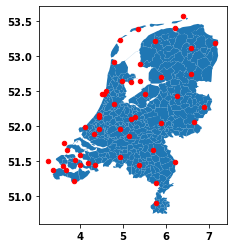

In [15]:
# fig, axs = plt.subplots()
# gdf.plot(ax=axs)
# axs.scatter(df_station['Longitude'], df_station['Lattitude'], color='red', s=20)

fig, axs = plt.subplots()
gdf.plot(ax=axs)
axs.scatter(df_station['Longitude'], df_station['Lattitude'], color='red', s=20)
plt.show()

In [16]:
import plotly.express as px

In [17]:
df_test = pd.merge(df,df_station, left_on = ['Station_Number'], right_on = ['STN'] )

In [21]:
mean_daily_temperature = df_test['Daily mean temperature'].mean()
df_test['Daily mean temperature'].fillna(value = mean_daily_temperature, inplace = True)

In [24]:
df_test = df_test[(df_test['year']== 2021) & (df_test['month']==12)]

In [25]:
fig = px.scatter_mapbox(
    df_test,   
    lat="Lattitude", 
    lon="Longitude", 
    size="Daily mean temperature", 
    color_continuous_scale=px.colors.cyclical.IceFire, 
    size_max=15, 
    mapbox_style="carto-darkmatter",
    zoom=1)
fig.show()

In [26]:
m = folium.Map(location = [ 53.24502187700006, 7.194590691000087])
# m
for i, coordinates in enumerate(geo_df_list):
    folium.CircleMarker(location = coordinates, color = "red", radius = 0.5,
                popup =  f"{geo_df.NAME.iloc[i]}").add_to(m)
m

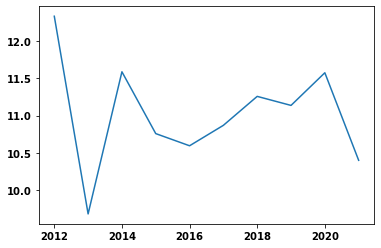

In [27]:
from matplotlib import pyplot as plt
x = df.groupby('year').mean()['Daily mean temperature']
fig, ax = plt.subplots()
ax.plot(x)
plt.show()

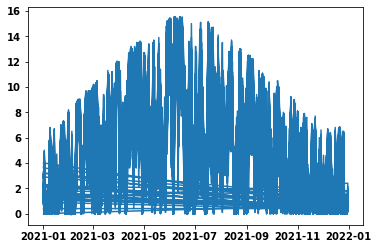

In [29]:
df_2021 = df[df['year']==2021]
plt.plot(df_2021['Date'],df_2021['Sunshine duration'])

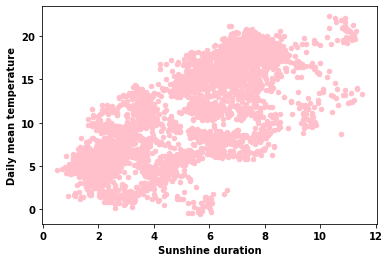

In [30]:
#selecting object using row (axis = 0) and loc means retrieving data using label
x = df_agg.loc(axis =0)[:2021][['Daily mean temperature','Sunshine duration']]
x.plot.scatter(x='Sunshine duration', y ='Daily mean temperature', c= 'pink' )
plt.show()

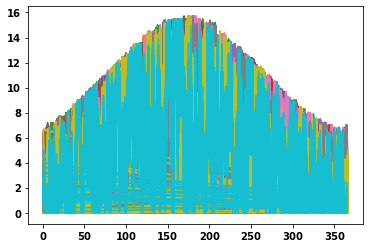

In [31]:
years = list(df['year'].unique())
for year in years:
    df_year = df[df['year']== year]
    plt.plot(df_year['day_of_year'], df_year['Sunshine duration'])

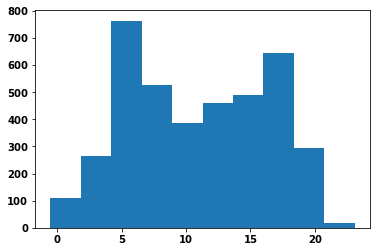

In [32]:
x = df_agg.loc(axis=0)[:2021][['Daily mean temperature']]
ax = plt.subplot()
ax.hist(x)
plt.show()

In [33]:
df_agg = df_agg.reset_index('year')

<AxesSubplot:>

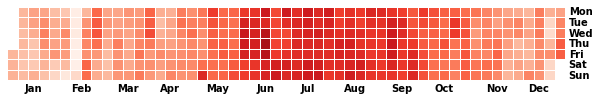

In [34]:
import calmap
df3 = df.set_index('Date')
event = df3['Daily mean temperature']
fig,ax = plt.subplots(figsize = (10,2))
calmap.yearplot(event, year=2021, ax=ax)

<AxesSubplot:>

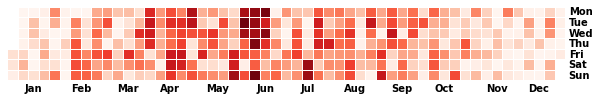

In [35]:
event2 = df3['Sunshine duration']
fig,ax = plt.subplots(figsize = (10,2))
calmap.yearplot(event2, year=2021, ax = ax)

(<Figure size 1800x720 with 10 Axes>,
 array([<AxesSubplot:ylabel='2012'>, <AxesSubplot:ylabel='2013'>,
        <AxesSubplot:ylabel='2014'>, <AxesSubplot:ylabel='2015'>,
        <AxesSubplot:ylabel='2016'>, <AxesSubplot:ylabel='2017'>,
        <AxesSubplot:ylabel='2018'>, <AxesSubplot:ylabel='2019'>,
        <AxesSubplot:ylabel='2020'>, <AxesSubplot:ylabel='2021'>],
       dtype=object))

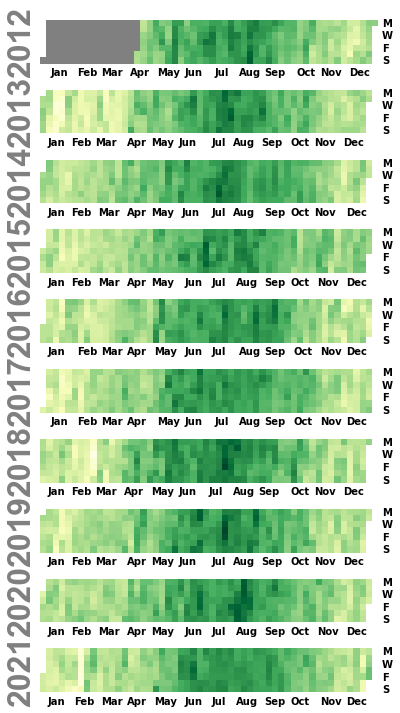

In [36]:
calmap.calendarplot(event, monthticks=4, daylabels='MTWTFSS',
                    dayticks=[0, 2, 4, 6], cmap='YlGn',
                    fillcolor='grey', linewidth=0,
                    fig_kws=dict(figsize=(25, 10)))

## World Happiness Country

In [11]:
speeches_df = pd.read_csv('Data/Processed/preprocessed_speech.csv')
countries = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
# CIC = pd.read_csv("RDMS Country Income.csv")

In [8]:
def interpolate(df, col, country):
    minidf = pd.DataFrame({col : df[col].loc[:,country].interpolate(method='slinear')})
    minidf['country'] = country
    minidf = minidf.reset_index()
    minidf.set_index(['year', 'country'], inplace=True)
    return df.update(minidf)

countries = speeches_df.reset_index()['country'].unique()
cols = ['Life Ladder', 'Log GDP per capita', 'Social support',
        'Healthy life expectancy at birth', 'Freedom to make life choices',
        'Generosity', 'Perceptions of corruption', 'Positive affect', 
        'Negative affect']

def multi_interpolate(df, columns, countries):
    for country in countries:
        for column in columns:
            try:
                interpolate(df, column, country)
            except:
                print(f"FAIL: {country} : {column}")
    return df

#speeches_df.reset_index(['year','country'], inplace=True)


multi_interpolate(speeches_df, cols, countries)

FAIL: ALB : Life Ladder
FAIL: ALB : Log GDP per capita
FAIL: ALB : Social support
FAIL: ALB : Healthy life expectancy at birth
FAIL: ALB : Freedom to make life choices
FAIL: ALB : Generosity
FAIL: ALB : Perceptions of corruption
FAIL: ALB : Positive affect
FAIL: ALB : Negative affect
FAIL: ARG : Life Ladder
FAIL: ARG : Log GDP per capita
FAIL: ARG : Social support
FAIL: ARG : Healthy life expectancy at birth
FAIL: ARG : Freedom to make life choices
FAIL: ARG : Generosity
FAIL: ARG : Perceptions of corruption
FAIL: ARG : Positive affect
FAIL: ARG : Negative affect
FAIL: AUS : Life Ladder
FAIL: AUS : Log GDP per capita
FAIL: AUS : Social support
FAIL: AUS : Healthy life expectancy at birth
FAIL: AUS : Freedom to make life choices
FAIL: AUS : Generosity
FAIL: AUS : Perceptions of corruption
FAIL: AUS : Positive affect
FAIL: AUS : Negative affect
FAIL: AUT : Life Ladder
FAIL: AUT : Log GDP per capita
FAIL: AUT : Social support
FAIL: AUT : Healthy life expectancy at birth
FAIL: AUT : Freedo

,Unnamed: 0.1,Unnamed: 0,session_nr,year,country,word_count,pos_sentiment,neu_sentiment,neg_sentiment,average_sentence_length,most_used_words,speech,preprocessed_speech,Global Code,Global Name,Region Code,Region Name,Sub-region Code,Sub-region Name,Intermediate Region Code,Intermediate Region Name,Country or Area,M49 Code,ISO-alpha2 Code,ISO-alpha3 Code,Least Developed Countries (LDC),Land Locked Developing Countries (LLDC),Small Island Developing States (SIDS),Developed / Developing Countries,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect
0,0,0,25,1970,ALB,4022,0.155,0.735,0.110,754.176471,"(['people', 'imperialist', 'struggle', 'soviet...",May I first convey to our President the congra...,may first convey president congratulation alba...,1.0,World,150.0,Europe,39.0,Southern Europe,NaN,NaN,Albania,8.0,AL,ALB,NaN,NaN,NaN,Developed,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,25,1970,ARG,2311,0.171,0.745,0.084,540.277778,"(['nation', 'international', 'united', 'state'...",It is a fortunate coincidence that precisely a...,fortunate coincidence precisely time united na...,1.0,World,19.0,Americas,419.0,Latin America and the Caribbean,5.0,South America,Argentina,32.0,AR,ARG,NaN,NaN,NaN,Developing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,2,25,1970,AUS,2531,0.145,0.772,0.083,422.466667,"(['nation', 'united', 'development', 'country'...","It is a pleasure for me to extend to you, Mr. ...",pleasure extend president warm congratulation ...,1.0,World,9.0,Oceania,53.0,Australia and New Zealand,NaN,NaN,Australia,36.0,AU,AUS,NaN,NaN,NaN,Developed,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,3,25,1970,AUT,2134,0.202,0.737,0.061,564.234043,"(['state', 'nation', 'united', 'international'...",May I begin by expressing to Ambassador Hambro...,may begin express ambassador hambro behalf del...,1.0,World,150.0,Europe,155.0,Western Europe,NaN,NaN,Austria,40.0,AT,AUT,NaN,NaN,NaN,Developed,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,4,25,1970,BEL,2009,0.163,0.793,0.045,415.822581,"(['regional', 'security', 'country', 'charter'...","No doubt each of us, before coming up to this ...",doubt u come rostrum wonder usefulness futilit...,1.0,World,150.0,Europe,155.0,Western Europe,NaN,NaN,Belgium,56.0,BE,BEL,NaN,NaN,NaN,Developed,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8493,8493,8493,75,2020,WSM,1018,0.167,0.767,0.066,289.925000,"(['un', 'samoa', 'nation', 'united', 'need', '...","Mr. President,\nDistinguished delegates,\nLadi...",president distinguish delegate lady gentleman ...,1.0,World,9.0,Oceania,61.0,Polynesia,NaN,NaN,Samoa,882.0,WS,WSM,NaN,NaN,x,Developing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8494,8494,8494,75,2020,YEM,707,0.194,0.714,0.093,437.947368,"(['people', 'united', 'nation', 'militia', 'ef...",In the name of God the Merciful and the Compas...,name god merciful compassionate excellency pre...,1.0,World,142.0,Asia,145.0,Western Asia,NaN,NaN,Yemen,887.0,YE,YEM,x,NaN,NaN,Developing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8495,8495,8495,75,2020,ZAF,751,0.166,0.731,0.103,147.688525,"(['must', 'world', 'nation', 'pandemic', 'afri...","President of the General Assembly, Secretary-G...",president general assembly excellency lady gen...,1.0,World,2.0,Africa,202.0,Sub-Saharan Africa,18.0,Southern Africa,South Africa,710.0,ZA,ZAF,NaN,NaN,NaN,Developing,4.946801,9.332463,0.891050,57.299999,0.756946,-0.014951,0.912407,0.820338,0.294276
8496,8496,8496,75,2020,ZMB,355,0.205,0.753,0.042,153.206897,"(['president', 'united', 'nation', 'u', 'excel...","Your excellency Mr. Volkan Bozkir, President o...",excellency volkan bozkir president session uni...,1.0,World,2.0,Africa,202.0,Sub-Saharan Africa,14.0,Eastern Africa,Zambia,894.0,ZM,ZMB,x,x,NaN,Developing,4.837992,8.116580,0.766872,56.299999,0.750422,0.0

In [13]:
df_worldhappiness = pd.merge(speeches_df,countries, left_on = 'country', right_on = 'iso_a3')
# df_worldhappiness = pd.merge(CIC, df_worldhappiness,  right_on = 'ISO-alpha2 Code', left_on = 'Country_Code')
df_worldhappiness['GDP per Capita']= np.exp(df_worldhappiness['Log GDP per capita'])

In [14]:
gdf_worldhappiness = GeoDataFrame(df_worldhappiness, geometry=df_worldhappiness['geometry'])
gdf_worldhappiness_point = gdf_worldhappiness.copy()
gdf_worldhappiness_point['geometry']= gdf_worldhappiness_point['geometry'].centroid
gdf_worldhappiness_point = gdf_worldhappiness_point.sort_values('year', ascending = True)

In [16]:
longitude, latitude = gdf_worldhappiness_point['geometry'].x, gdf_worldhappiness_point['geometry'].y
gdf_worldhappiness_point['longitude']= longitude
gdf_worldhappiness_point['latitude']= latitude

In [17]:
gdf_worldhappiness_2019 = gdf_worldhappiness[gdf_worldhappiness['year']==2019]
gdf_worldhappiness_point_2019 = gdf_worldhappiness_point[gdf_worldhappiness_point['year']==2019]

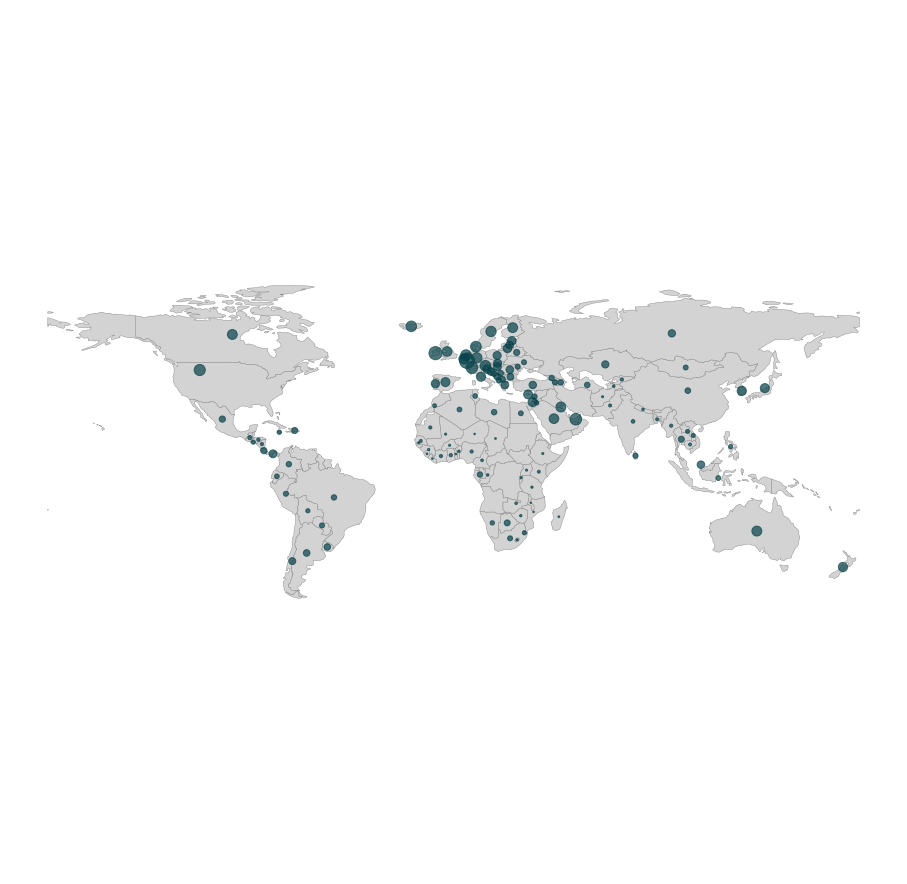

In [18]:
#bubble
fig, ax = plt.subplots(figsize=(16,16))
marker = gdf_worldhappiness_point_2019['GDP per Capita']/500
gdf_worldhappiness_2019.plot(ax=ax, color="lightgray", edgecolor="grey", linewidth=0.4)
gdf_worldhappiness_point_2019.plot(ax=ax,color="#07424A", markersize=marker,alpha=0.7, categorical=False, legend=True  )
ax.axis("off")
plt.axis('equal')
plt.show()

<AxesSubplot:>

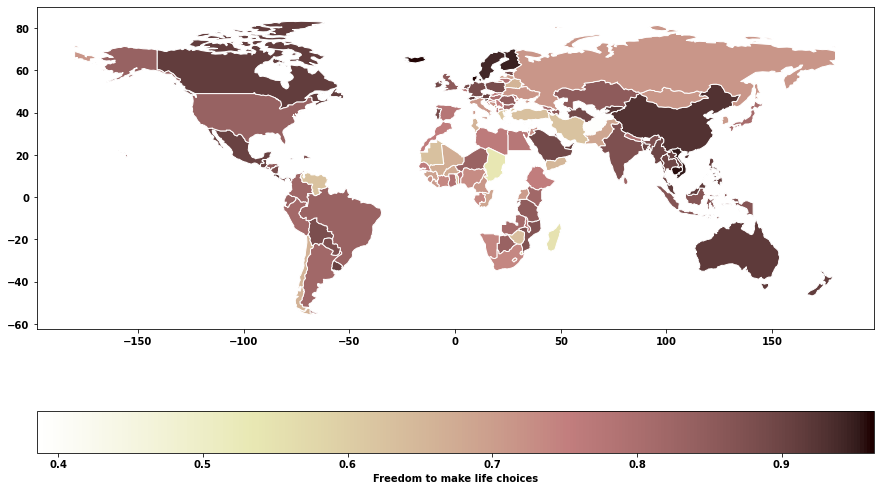

In [19]:
#choropleth
gdf_worldhappiness_2019.plot(column = "Freedom to make life choices", 
                           figsize=(15,10),
                           legend=True,
                           edgecolor="white",
                        cmap = 'pink_r',
                           legend_kwds={"label":"Freedom to make life choices", "orientation":"horizontal"})

In [152]:
#plottly
fig1 = px.scatter_mapbox(
    gdf_worldhappiness_point_2019.dropna(subset = 'GDP per Capita'),   
    lat="latitude", 
    lon="longitude", 
    color = 'continent',
    size= 'GDP per Capita', 
    color_continuous_scale=px.colors.cyclical.IceFire, 
    size_max=15, 
    hover_name = 'name',
    mapbox_style="carto-darkmatter",
    zoom=1)
fig1.show()

In [33]:
gdf_worldhappiness_point['Land Locked Developing Countries (LLDC)'].fillna(value = 'No', inplace = True)
gdf_worldhappiness_point['Land Locked Developing Countries (LLDC)'].replace(['x'], ['Yes'], inplace=True)
gdf_worldhappiness_point['Land Locked Developing Countries (LLDC)'].unique()

array(['No', 'Yes'], dtype=object)

In [21]:
#plotty express
#gdf_worldhappiness_pointpx = px.data.gapminder()
fig2 = px.scatter(
    gdf_worldhappiness_point.dropna(subset = ['GDP per Capita', 'Life Ladder']),   
#     lat="latitude", 
#     lon="longitude", 
    color = 'Region Name',
    size= 'GDP per Capita', 
    color_continuous_scale=px.colors.cyclical.IceFire, 
    animation_frame= "year",
     animation_group="country",
    hover_name = 'name',
    size_max=35, 
    #mapbox_style="carto-darkmatter",
    x="GDP per Capita", y="Life Ladder"
    #
    ,log_x = True
)
  #   range_x=[100,100000], range_y=[25,90]),
fig2.show()

In [28]:
#gdf_worldhappiness_pointpx = px.data.gapminder()
fig3 = px.scatter(
    gdf_worldhappiness_point.dropna(subset = 'GDP per Capita'),   
    color = 'Region Name',
    size= 'GDP per Capita', 
      color_continuous_scale=px.colors.cyclical.IceFire, 
    animation_frame= "year",
     animation_group="country",
    hover_name = 'name',
    size_max=35, 
    x="GDP per Capita", y="Healthy life expectancy at birth"
 ,color_discrete_map={"Europe": 'rgba(260,0,0,0.4)'}
    ,log_x = True
)
fig3.show()



In [15]:
# Conflict Dataset Points
acled = gpd.read_file(
    "./5-+Interactive+Visualization (1)/data/acled2019.shp",
    mask = countries[countries["continent"] == "Africa"]
)
acled = acled[(acled['event_type'] == 'Battles') | (acled['event_type'] == 'Violence against civilians') |
              (acled['event_type'] == 'Riots') | (acled['event_type'] == 'Explosions/Remote violence')]

In [27]:
Africa = countries[countries['continent']== 'Africa']
Africa['geometry_point'] = Africa['geometry'].centroid
Africa['geometry'] = Africa['geometry_point']
Alongitude, Alatitude = Africa['geometry'].x, Africa['geometry'].y

C:\Temp\ipykernel_6788\1976617603.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  Africa['geometry_point'] = Africa['geometry'].centroid
C:\Users\lcu1812\Anaconda3\envs\geo_env\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [24]:
Alongitude, Alatitude = Africa['geometry'].x, Africa['geometry'].y
Africa['longitude']= Alongitude
Africa['latitude']= Alatitude

C:\Users\lcu1812\Anaconda3\envs\geo_env\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
C:\Users\lcu1812\Anaconda3\envs\geo_env\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


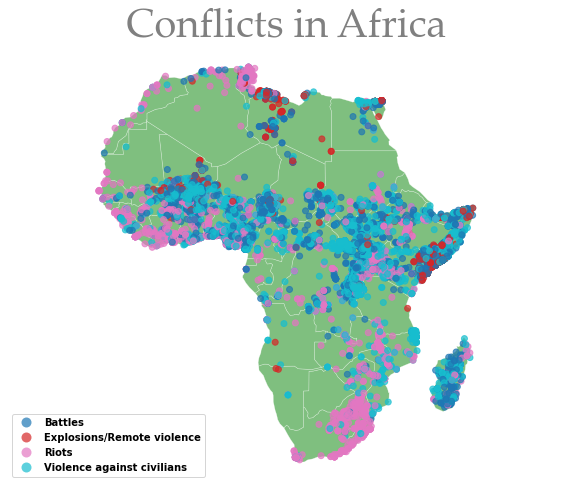

In [28]:
#multiplayer maps
fig, ax = plt.subplots(1,1,  figsize=(10,8))
Africa.plot(ax=ax, linewidth=0.5,edgecolor = 'white',facecolor = 'Green', alpha=0.5);
acled.plot(ax= ax,
           column = 'event_type',
                alpha=0.7,
          legend = 'event_type');

plt.title('Conflicts in Africa', fontsize=40, fontname="Palatino Linotype", color="grey")
ax.axis("off")
plt.axis('equal')
plt.show()

In [23]:
import chart_studio
username = 'Lanchu' # your username
api_key = 'uxFwbYQLLfmFfA6hZFXJ' # your api key - go to profile > settings > regenerate key
chart_studio.tools.set_credentials_file(username=username, api_key=api_key)
py.plot(fig2, filename = 'gdp_per_cap', auto_open=True)

In [150]:
py.plot(fig3, filename = 'gdp_per_cap', auto_open=True)

'https://plotly.com/~Lanchu/1/'

In [28]:
def color_producer(event_type):
    if event_type == 'Battles':
        return 'lightblue'
    elif event_type == 'Violence against civilians':
        return 'green'
    elif event_type == 'Riots':
        return 'pink'
    else:
        return 'red'
m = folium.Map()
geo_Africa_list = [[point.xy[1][0], point.xy[0][0]] for point in acled.geometry ]
for i, coordinates in enumerate(geo_Africa_list):
    color = color_producer(acled.event_type.iloc[i])
    folium.CircleMarker(location = coordinates, color = color, radius = 0.5
        ,popup =  f"{acled.event_type.iloc[i]}"
                       ).add_to(m)
m